<a href="https://colab.research.google.com/github/sirishant/TripleRider-Detection/blob/main/ubuntu_yolov8_custom_training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Ultralytics' YOLOv8 model used for object detection
!pip install -U ultralytics

In [ ]:
## importing required libraries
import os
import shutil
import random

# Upgrade tqdm library
# used for drawing progress bars
!pip install tqdm --upgrade
from tqdm.notebook import tqdm

In [ ]:
# Define paths for training, validation, and testing images and labels
train_path_img = "/home/sirishant/Desktop/yolov8t3/yolo_data/images/train"
train_path_label = "/home/sirishant/Desktop/yolov8t3/yolo_data/labels/train"
val_path_img = "/home/sirishant/Desktop/yolov8t3/yolo_data/images/val"
val_path_label = "/home/sirishant/Desktop/yolov8t3/yolo_data/labels/val"
test_path = "/home/sirishant/Desktop/yolov8t3/yolo_data/test"

In [ ]:
## ################################################################################## ##
#   Split the dataset into train and test and creates the train.txt and test.tx with   #
#   the respective path of the images in each folder                                   #
## ################################################################################## ##

def train_test_split(path,neg_path=None, split = 0.2):
    print("------ PROCESS STARTED -------")

    # Get a list of unique filenames without extensions
    files = list(set([name[:-4] for name in os.listdir(path)])) ## removing duplicate names i.e. counting only number of images


    print (f"--- This folder has a total number of {len(files)} images---")
    random.seed(42)
    random.shuffle(files)

    # Calculate sizes for training and testing sets
    test_size = int(len(files) * split)
    train_size = len(files) - test_size

    ## creating required directories

    os.makedirs(train_path_img, exist_ok = True)
    os.makedirs(train_path_label, exist_ok = True)
    os.makedirs(val_path_img, exist_ok = True)
    os.makedirs(val_path_label, exist_ok = True)


    ### ----------- copying images to train folder
    for filex in tqdm(files[:train_size]):
      if filex == 'classes':
          continue
      shutil.copy2(path + filex + '.png',f"{train_path_img}/" + filex + '.png' )
      shutil.copy2(path + filex + '.txt', f"{train_path_label}/" + filex + '.txt')



    print(f"------ Training data created with 80% split {len(files[:train_size])} images -------")

    if neg_path:
        # Get a list of unique filenames without extensions from negative images folder
        neg_images = list(set([name[:-4] for name in os.listdir(neg_path)])) ## removing duplicate names i.e. counting only number of images
        for filex in tqdm(neg_images):
            shutil.copy2(neg_path+filex+ ".png", f"{train_path_img}/" + filex + '.png')

        print(f"------ Total  {len(neg_images)} negative images added to the training data -------")

        print(f"------ TOTAL Training data created with {len(files[:train_size]) + len(neg_images)} images -------")



    ### copying images to validation folder
    for filex in tqdm(files[train_size:]):
      if filex == 'classes':
          continue
      # print("running")
      shutil.copy2(path + filex + '.png', f"{val_path_img}/" + filex + '.png' )
      shutil.copy2(path + filex + '.txt', f"{val_path_label}/" + filex + '.txt')

    print(f"------ Testing data created with a total of {len(files[train_size:])} images ----------")

    print("------ TASK COMPLETED -------")

## spliting the data into train-test and creating train.txt and test.txt files
# train_test_split('/content/drive/MyDrive/custom_notebooks/yolo_data/')

### for label_tag
train_test_split('/home/sirishant/Desktop/yolov8t3/data/') ### without negative images
# train_test_split('./data/','./negative_images/') ### if you want to feed negative images

------ PROCESS STARTED -------
--- This folder has a total number of 858 images---


  0%|          | 0/687 [00:00<?, ?it/s]

------ Training data created with 80% split 687 images -------


  0%|          | 0/171 [00:00<?, ?it/s]

------ Testing data created with a total of 171 images ----------
------ TASK COMPLETED -------


In [ ]:
# Import Ultralytics library
import ultralytics

# Check the Ultralytics library and for CUDA availability (GPU)
ultralytics.checks()

Ultralytics YOLOv8.2.11 🚀 Python-3.11.7 torch-2.3.0+cu121 CUDA:0 (NVIDIA GeForce RTX 3070 Laptop GPU, 7949MiB)
Setup complete ✅ (16 CPUs, 31.2 GB RAM, 141.7/187.9 GB disk)


## Training

In [ ]:
# Command to start training YOLOv8 model using Ultralytics library

# Parameters:
# - task: 'detect' specifies the detection task
# - mode: 'train' indicates training mode
# - model: 'yolov8s.pt' specifies the YOLOv8 model architecture to use
# - data: '/home/sirishant/Desktop/yolov8t3/dataset.yaml' provides the path to the dataset configuration file
# - epochs: '15' sets the number of training epochs
# - imgsz: '640' specifies the input image size during training
# - batch: '8' sets the batch size for training
# - seed: '1' sets the random seed for reproducibility
# - project: '/home/sirishant/Desktop/yolov8t3/training_results' specifies the directory to save training results
# - name: 'triple' sets the name of the training run
!yolo task=detect mode=train model=yolov8s.pt data=/home/sirishant/Desktop/yolov8t3/dataset.yaml epochs=10 imgsz=640 batch=8 project=/home/sirishant/Desktop/yolov8t3/training_results name=triple

Ultralytics YOLOv8.2.18 🚀 Python-3.11.7 torch-2.3.0+cu121 CUDA:0 (NVIDIA GeForce RTX 3070 Laptop GPU, 7949MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/home/sirishant/Desktop/yolov8t3/dataset.yaml, epochs=10, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/home/sirishant/Desktop/yolov8t3/training_results, name=triple5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, 

## Inferencing

In [ ]:
# Command to perform object detection prediction using trained YOLOv8 model

# Parameters:
# - task: 'detect' specifies the detection task
# - mode: 'predict' indicates prediction mode
# - model: '/home/sirishant/Desktop/yolov8t3/training_results/triple3/weights/best.pt' specifies the path to the trained model weights
# - conf: '0.35' sets the confidence threshold for object detection
# - source: '/home/sirishant/Desktop/yolov8t3/test_images' specifies the directory containing test images
# - save: 'True' indicates to save the resulting images with bounding boxes
# - save_txt: 'True' indicates to save the predicted bounding boxes in text files


!yolo task=detect mode=predict model=/home/sirishant/Desktop/yolov8t3/training_results/triple/weights/best.pt conf=0.2 source=/home/sirishant/Desktop/yolov8t3/test_images save=False save_txt=True

Ultralytics YOLOv8.2.18 🚀 Python-3.11.7 torch-2.3.0+cu121 CUDA:0 (NVIDIA GeForce RTX 3070 Laptop GPU, 7949MiB)
Model summary (fused): 168 layers, 11127132 parameters, 0 gradients, 28.4 GFLOPs

image 1/63 /home/sirishant/Desktop/yolov8t3/test_images/PXL_20240510_154804782.jpg: 480x640 1 rider, 2 heads, 2 numplates, 81.5ms
image 2/63 /home/sirishant/Desktop/yolov8t3/test_images/PXL_20240510_154808887.jpg: 480x640 1 rider, 1 head, 5.1ms
image 3/63 /home/sirishant/Desktop/yolov8t3/test_images/PXL_20240510_154846749.jpg: 480x640 1 rider, 2 heads, 1 numplate, 5.0ms
image 4/63 /home/sirishant/Desktop/yolov8t3/test_images/PXL_20240510_154855893.jpg: 480x640 1 rider, 5 heads, 5.1ms
image 5/63 /home/sirishant/Desktop/yolov8t3/test_images/PXL_20240510_154917557.jpg: 480x640 1 rider, 5.3ms
image 6/63 /home/sirishant/Desktop/yolov8t3/test_images/PXL_20240510_154927020.jpg: 480x640 1 rider, 1 head, 4.9ms
image 7/63 /home/sirishant/Desktop/yolov8t3/test_images/PXL_20240510_154956929.jpg: 480x640 1 ri

### Labeling as Single, Double or Triple based on heads


In [ ]:
txt_folder = '/home/sirishant/Desktop/yolov8t3/runs/detect/predict/labels'
img_folder = '/home/sirishant/Desktop/yolov8t3/test_images'
output_folder = '/home/sirishant/Desktop/yolov8t3/output'

In [ ]:
## Classify heads

import os

def classify_riders_in_directory(directory):
    for filename in os.listdir(directory):
        if filename.endswith(".txt"):
            file_path = os.path.join(directory, filename)
            classified_labels = classify_riders(file_path)
            if classified_labels:
                output_file_path = os.path.join(directory, filename.replace(".txt", "_classified.txt"))
                write_labels_to_file(output_file_path, classified_labels)
                print("Classified labels saved to:", output_file_path)
            else:
                print("No riders found in:", file_path)

def classify_riders(file_path):
    with open(file_path, 'r') as file:
        lines = file.readlines()

    rider_bboxes = []
    head_bboxes = []
    numplate_bboxes = []

    for line in lines:
        class_idx, x_center, y_center, width, height = map(float, line.strip().split())
        if class_idx == 0:
            rider_bboxes.append([x_center - width/2, y_center - height/2, x_center + width/2, y_center + height/2])
        elif class_idx == 1:
            head_bboxes.append([x_center - width/2, y_center - height/2, x_center + width/2, y_center + height/2])
        elif class_idx == 2:
            numplate_bboxes.append([x_center - width/2, y_center - height/2, x_center + width/2, y_center + height/2])

    print("rider_bboxes:", rider_bboxes)
    print("head_bboxes:", head_bboxes)
    print("numplate_bboxes:", numplate_bboxes)

    classified_labels = []

    for rider_bbox in rider_bboxes:
        rider_class, _ = classify_rider(rider_bbox, head_bboxes)
        if rider_class is not None:
            classified_labels.append([rider_class] + rider_bbox)

    for head_bbox in head_bboxes:
        classified_labels.append([3] + head_bbox)

    for numplate_bbox in numplate_bboxes:
        classified_labels.append([4] + numplate_bbox)

    return classified_labels

def classify_rider(rider_bbox, head_bboxes):
    head_count = 0

    for head_bbox in head_bboxes:
        head_center_x = (head_bbox[0] + head_bbox[2]) / 2
        head_center_y = (head_bbox[1] + head_bbox[3]) / 2
        if (rider_bbox[0] <= head_center_x <= rider_bbox[2] and
            rider_bbox[1] <= head_center_y <= rider_bbox[3]):
            head_count += 1

    print("Head count for rider:", head_count)

    if head_count == 1:
        return 0, head_count  # "single"
    elif head_count == 2:
        return 1, head_count  # "double"
    elif head_count >= 3:
        return 2, head_count  # "triple"
    else:
        return None, head_count  # No heads found


def write_labels_to_file(output_file_path, classified_labels):
    with open(output_file_path, 'w') as file:
        for label in classified_labels:
            classification = "single" if label[0] == 0 else ("double" if label[0] == 1 else ("triple" if label[0] == 2 else ("head" if label[0] == 3 else "numplate")))
            x_center = (label[1] + label[3]) / 2
            y_center = (label[2] + label[4]) / 2
            width = label[3] - label[1]
            height = label[4] - label[2]
            file.write(f"{classification} {x_center} {y_center} {width} {height}\n")

print("Classifying riders in directory:", txt_folder)
classify_riders_in_directory(txt_folder)
print("Classification completed.")


Classifying riders in directory: /home/sirishant/Desktop/yolov8t3/runs/detect/predict/labels


ValueError: could not convert string to float: 'double'

In [ ]:
# Draw labels

import os
import cv2
from tqdm import tqdm

def draw_labels_on_images(txt_folder, img_folder, output_folder):
    # Get list of txt files
    txt_files = [f for f in os.listdir(txt_folder) if f.endswith("_classified.txt")]
    # Iterate over txt files with tqdm
    for txt_file in tqdm(txt_files, desc="Processing files"):
        img_file = os.path.join(img_folder, txt_file.replace("_classified.txt", ".jpg"))
        if os.path.exists(img_file):
            image = cv2.imread(img_file)
            with open(os.path.join(txt_folder, txt_file), 'r') as txt:
                for line in txt:
                    parts = line.strip().split()
                    classification = parts[0]
                    x_center, y_center, width, height = map(float, parts[1:])
                    x_min = int((x_center - width / 2) * image.shape[1])
                    y_min = int((y_center - height / 2) * image.shape[0])
                    x_max = int((x_center + width / 2) * image.shape[1])
                    y_max = int((y_center + height / 2) * image.shape[0])
                    # print("Bounding box coordinates:", x_min, y_min, x_max, y_max)
                    color = (0, 255, 0)  # Default color for single
                    label_text = "Single"
                    if classification == "double":
                        color = (255, 255, 0)
                        label_text = "Double"
                    elif classification == "triple":
                        color = (0, 0, 255)
                        label_text = "Triple"
                    elif classification == "head":
                        color = (255, 255, 255)
                        label_text = "Head"
                    elif classification == "numplate":
                        color = (0, 255, 255)
                        label_text = "Numplate"
                    cv2.rectangle(image, (x_min, y_min), (x_max, y_max), color, 2)
                    cv2.putText(image, label_text, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
            output_file = os.path.join(output_folder, txt_file.replace("_classified.txt", ".jpg"))
            cv2.imwrite(output_file, image)
            # print("Labels drawn on:", output_file)


draw_labels_on_images(txt_folder, img_folder, output_folder)

Processing files: 100%|█████████████████████████| 57/57 [00:14<00:00,  3.98it/s]


### inferencing on video


In [ ]:
import cv2
import os
from tqdm import tqdm

def extract_frames(video_path, output_folder):
    # Get the basename of the video file (without extension)
    video_name = os.path.splitext(os.path.basename(video_path))[0]
    # Create the output folder if it doesn't exist
    output_folder_path = os.path.join(output_folder, video_name)

    # Check if frames folder already exists
    if not os.path.exists(output_folder_path):
        # Open the video file

        cap = cv2.VideoCapture(video_path)
        os.makedirs(output_folder_path)
        # Counter for frame number
        frame_count = 0
        # Get total frames in the video
        total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

        # Use tqdm for progress bar
        with tqdm(total=total_frames, desc=f"Extracting frames from {video_name}") as pbar:
            # Read until video is completed
            while(cap.isOpened()):
                # Capture frame-by-frame
                ret, frame = cap.read()

                if ret == True:
                    # Save the frame as an image
                    frame_path = os.path.join(output_folder_path, f"{video_name}_frame_{frame_count}.jpg")
                    cv2.imwrite(frame_path, frame)
                    frame_count += 1
                    pbar.update(1)
                else:
                    break

            # Release the VideoCapture object
            cap.release()

# Path to the folder containing videos
videos_folder = "/home/sirishant/Desktop/yolov8t3/vid"
# Path to the output folder
output_folder = "/home/sirishant/Desktop/yolov8t3/vid/frames"

# Iterate through each file in the videos folder
for file_name in os.listdir(videos_folder):
    # Check if the file is of type mp4 or MOV
    if file_name.endswith(".mp4") or file_name.endswith(".MOV"):
        video_path = os.path.join(videos_folder, file_name)
        # Extract frames from the video if frames are not already extracted
        extract_frames(video_path, output_folder)


Extracting frames from vid8: 100%|██████████| 1666/1666 [03:54<00:00,  7.12it/s]


In [ ]:
# Command to perform object detection prediction using trained YOLOv8 model

# Parameters:
# - task: 'detect' specifies the detection task
# - mode: 'predict' indicates prediction mode
# - model: '/home/sirishant/Desktop/yolov8t3/training_results/triple3/weights/best.pt' specifies the path to the trained model weights
# - conf: '0.35' sets the confidence threshold for object detection
# - source: '/home/sirishant/Desktop/yolov8t3/test_images' specifies the directory containing test images
# - save: 'True' indicates to save the resulting images with bounding boxes
# - save_txt: 'True' indicates to save the predicted bounding boxes in text files


!yolo task=detect mode=predict model=/home/sirishant/Desktop/yolov8t3/training_results/triple/weights/best.pt conf=0.1 source=/home/sirishant/Desktop/yolov8t3/vid/frames/vid1 save=False save_txt=True
!yolo task=detect mode=predict model=/home/sirishant/Desktop/yolov8t3/training_results/triple/weights/best.pt conf=0.1 source=/home/sirishant/Desktop/yolov8t3/vid/frames/vid2 save=False save_txt=True
!yolo task=detect mode=predict model=/home/sirishant/Desktop/yolov8t3/training_results/triple/weights/best.pt conf=0.1 source=/home/sirishant/Desktop/yolov8t3/vid/frames/vid3 save=False save_txt=True
!yolo task=detect mode=predict model=/home/sirishant/Desktop/yolov8t3/training_results/triple/weights/best.pt conf=0.1 source=/home/sirishant/Desktop/yolov8t3/vid/frames/vid4 save=False save_txt=True
!yolo task=detect mode=predict model=/home/sirishant/Desktop/yolov8t3/training_results/triple/weights/best.pt conf=0.1 source=/home/sirishant/Desktop/yolov8t3/vid/frames/vid5 save=False save_txt=True
#!yolo task=detect mode=predict model=/home/sirishant/Desktop/yolov8t3/training_results/triple/weights/best.pt conf=0.1 source=/home/sirishant/Desktop/yolov8t3/vid/frames/vid6 save=False save_txt=True
#!yolo task=detect mode=predict model=/home/sirishant/Desktop/yolov8t3/training_results/triple/weights/best.pt conf=0.1 source=/home/sirishant/Desktop/yolov8t3/vid/frames/vid7 save=False save_txt=True
#!yolo task=detect mode=predict model=/home/sirishant/Desktop/yolov8t3/training_results/triple/weights/best.pt conf=0.1 source=/home/sirishant/Desktop/yolov8t3/vid/frames/vid8 save=False save_txt=True

Streaming output truncated to the last 5000 lines.
image 2739/4200 /home/sirishant/Desktop/yolov8t3/vid/frames/vid3/vid3_frame_3462.jpg: 384x640 (no detections), 4.8ms
image 2740/4200 /home/sirishant/Desktop/yolov8t3/vid/frames/vid3/vid3_frame_3463.jpg: 384x640 (no detections), 5.0ms
image 2741/4200 /home/sirishant/Desktop/yolov8t3/vid/frames/vid3/vid3_frame_3464.jpg: 384x640 (no detections), 5.0ms
image 2742/4200 /home/sirishant/Desktop/yolov8t3/vid/frames/vid3/vid3_frame_3465.jpg: 384x640 (no detections), 4.8ms
image 2743/4200 /home/sirishant/Desktop/yolov8t3/vid/frames/vid3/vid3_frame_3466.jpg: 384x640 (no detections), 4.8ms
image 2744/4200 /home/sirishant/Desktop/yolov8t3/vid/frames/vid3/vid3_frame_3467.jpg: 384x640 (no detections), 4.8ms
image 2745/4200 /home/sirishant/Desktop/yolov8t3/vid/frames/vid3/vid3_frame_3468.jpg: 384x640 (no detections), 4.9ms
image 2746/4200 /home/sirishant/Desktop/yolov8t3/vid/frames/vid3/vid3_frame_3469.jpg: 384x640 (no detections), 4.8ms
image 2747/42

In [ ]:
# Classify heads for each video's each frame
## Classify heads

import os

def classify_riders_in_directory(directory):
    for filename in os.listdir(directory):
        if filename.endswith(".txt"):
            file_path = os.path.join(directory, filename)
            classified_labels = classify_riders(file_path)
            if classified_labels:
                output_file_path = os.path.join(directory, filename.replace(".txt", "_classified.txt"))
                write_labels_to_file(output_file_path, classified_labels)
                print("Classified labels saved to:", output_file_path)
            else:
                print("No riders found in:", file_path)

def classify_riders(file_path):
    with open(file_path, 'r') as file:
        lines = file.readlines()

    rider_bboxes = []
    head_bboxes = []
    numplate_bboxes = []

    for line in lines:
        class_idx, x_center, y_center, width, height = map(float, line.strip().split())
        if class_idx == 0:
            rider_bboxes.append([x_center - width/2, y_center - height/2, x_center + width/2, y_center + height/2])
        elif class_idx == 1:
            head_bboxes.append([x_center - width/2, y_center - height/2, x_center + width/2, y_center + height/2])
        elif class_idx == 2:
            numplate_bboxes.append([x_center - width/2, y_center - height/2, x_center + width/2, y_center + height/2])

    print("rider_bboxes:", rider_bboxes)
    print("head_bboxes:", head_bboxes)
    print("numplate_bboxes:", numplate_bboxes)

    classified_labels = []

    for rider_bbox in rider_bboxes:
        rider_class, _ = classify_rider(rider_bbox, head_bboxes)
        if rider_class is not None:
            classified_labels.append([rider_class] + rider_bbox)

    for head_bbox in head_bboxes:
        classified_labels.append([3] + head_bbox)

    for numplate_bbox in numplate_bboxes:
        classified_labels.append([4] + numplate_bbox)

    return classified_labels

def classify_rider(rider_bbox, head_bboxes):
    head_count = 0

    for head_bbox in head_bboxes:
        head_center_x = (head_bbox[0] + head_bbox[2]) / 2
        head_center_y = (head_bbox[1] + head_bbox[3]) / 2
        if (rider_bbox[0] <= head_center_x <= rider_bbox[2] and
            rider_bbox[1] <= head_center_y <= rider_bbox[3]):
            head_count += 1

    print("Head count for rider:", head_count)

    if head_count == 1:
        return 0, head_count  # "single"
    elif head_count == 2:
        return 1, head_count  # "double"
    elif head_count >= 3:
        return 2, head_count  # "triple"
    else:
        return None, head_count  # No heads found


def write_labels_to_file(output_file_path, classified_labels):
    with open(output_file_path, 'w') as file:
        for label in classified_labels:
            classification = "single" if label[0] == 0 else ("double" if label[0] == 1 else ("triple" if label[0] == 2 else ("head" if label[0] == 3 else "numplate")))
            x_center = (label[1] + label[3]) / 2
            y_center = (label[2] + label[4]) / 2
            width = label[3] - label[1]
            height = label[4] - label[2]
            file.write(f"{classification} {x_center} {y_center} {width} {height}\n")

for i in range(3,11): # Files are in predict3, predict4, predict5
  directory = f"/home/sirishant/Desktop/yolov8t3/runs/detect/predict{i}/labels"
  print("Classifying riders in directory:", directory)
  classify_riders_in_directory(directory)
print("Classification completed.")

Streaming output truncated to the last 5000 lines.
Head count for rider: 0
Classified labels saved to: /home/sirishant/Desktop/yolov8t3/runs/detect/predict7/labels/vid5_frame_200_classified.txt
rider_bboxes: [[0.0, 0.23558549999999995, 0.40055, 0.9937944999999999], [0.566522, 0.277211, 0.675548, 0.705037], [0.6640723500000001, 0.2664555, 0.75274365, 0.6086725], [0.7908215000000001, 0.29945, 0.8775465, 0.62645], [0.9280923, 0.35544749999999997, 0.9999996999999999, 0.9203585000000001]]
head_bboxes: [[0.60516485, 0.28858439999999996, 0.63923715, 0.3621196], [0.2449931, 0.28752695, 0.2814689, 0.36561905], [0.70400595, 0.29832455, 0.73038005, 0.35186344999999997], [0.80149705, 0.29574599999999995, 0.87479095, 0.410702], [0.1603212, 0.2934713, 0.1932068, 0.35598470000000004], [0.9076112999999999, 0.36857005, 0.9236107, 0.40429795], [0.77094845, 0.33787585, 0.78711155, 0.36973415], [0.8997214, 0.36194065, 0.9140246000000001, 0.39792735], [0.2151824, 0.2568112, 0.2515096, 0.33682480000000004],

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [ ]:
# Draw boundary boxes for each rider and head

# Draw labels

import os
import cv2
from tqdm import tqdm

def draw_labels_on_images(txt_folder, img_folder, output_folder):
    # Get list of txt files
    txt_files = [f for f in os.listdir(txt_folder) if f.endswith("_classified.txt")]
    # Iterate over txt files with tqdm
    for txt_file in tqdm(txt_files, desc="Processing files"):
        img_file = os.path.join(img_folder, txt_file.replace("_classified.txt", ".jpg"))
        if os.path.exists(img_file):
            image = cv2.imread(img_file)
            with open(os.path.join(txt_folder, txt_file), 'r') as txt:
                for line in txt:
                    parts = line.strip().split()
                    classification = parts[0]
                    x_center, y_center, width, height = map(float, parts[1:])
                    x_min = int((x_center - width / 2) * image.shape[1])
                    y_min = int((y_center - height / 2) * image.shape[0])
                    x_max = int((x_center + width / 2) * image.shape[1])
                    y_max = int((y_center + height / 2) * image.shape[0])
                    # print("Bounding box coordinates:", x_min, y_min, x_max, y_max)
                    color = (0, 255, 0)  # Default color for single
                    label_text = "Single"
                    if classification == "double":
                        color = (255, 255, 0)
                        label_text = "Double"
                    elif classification == "triple":
                        color = (0, 0, 255)
                        label_text = "Triple"
                    elif classification == "head":
                        color = (255, 255, 255)
                        label_text = "Head"
                    elif classification == "numplate":
                        color = (0, 255, 255)
                        label_text = "Numplate"
                    cv2.rectangle(image, (x_min, y_min), (x_max, y_max), color, 2)
                    cv2.putText(image, label_text, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
            output_file = os.path.join(output_folder, txt_file.replace("_classified.txt", ".jpg"))
            cv2.imwrite(output_file, image)
            # print("Labels drawn on:", output_file)

for i in range(3,11): # images in predict3, 4, 5
  txt_folder = f"/home/sirishant/Desktop/yolov8t3/runs/detect/predict{i}/labels"
  img_folder = f"/home/sirishant/Desktop/yolov8t3/vid/frames/vid{i-2}"
  output_folder = f"/home/sirishant/Desktop/yolov8t3/output/vid{i-2}"
  print("Drawing riders in directory:", txt_folder)
  draw_labels_on_images(txt_folder, img_folder, output_folder)

Drawing riders in directory: /home/sirishant/Desktop/yolov8t3/runs/detect/predict3/labels


Processing files: 100%|███████████████████████| 689/689 [01:23<00:00,  8.27it/s]


Drawing riders in directory: /home/sirishant/Desktop/yolov8t3/runs/detect/predict4/labels


Processing files: 100%|███████████████████████| 143/143 [00:07<00:00, 19.14it/s]


Drawing riders in directory: /home/sirishant/Desktop/yolov8t3/runs/detect/predict5/labels


Processing files: 100%|████████████████████| 1265/1265 [00:07<00:00, 160.13it/s]


Drawing riders in directory: /home/sirishant/Desktop/yolov8t3/runs/detect/predict6/labels


Processing files: 100%|█████████████████████| 1013/1013 [00:10<00:00, 94.23it/s]


Drawing riders in directory: /home/sirishant/Desktop/yolov8t3/runs/detect/predict7/labels


Processing files: 100%|█████████████████████| 1804/1804 [00:44<00:00, 40.73it/s]


Drawing riders in directory: /home/sirishant/Desktop/yolov8t3/runs/detect/predict8/labels


Processing files: 100%|███████████████████████| 544/544 [01:51<00:00,  4.86it/s]


Drawing riders in directory: /home/sirishant/Desktop/yolov8t3/runs/detect/predict9/labels


Processing files: 100%|███████████████████████| 107/107 [00:04<00:00, 22.61it/s]


Drawing riders in directory: /home/sirishant/Desktop/yolov8t3/runs/detect/predict10/labels


Processing files: 100%|███████████████████████| 436/436 [01:19<00:00,  5.50it/s]


In [ ]:
import cv2
import os
from tqdm import tqdm

def compile_video(frames_folder, output_folder, video_name):
    # Check if the output video already exists
    output_video_path = os.path.join(output_folder, f"{video_name}.mp4")
    if os.path.exists(output_video_path):
        print(f"Video '{video_name}.mp4' already exists. Skipping compilation.")
        return

    # Get the list of frames and sort numerically
    frames = sorted([f for f in os.listdir(frames_folder) if f.endswith('.jpg')],
                    key=lambda x: int(x.split('_')[-1].split('.')[0]))

    # Debug: Print the frames list
    print(f"Frames in '{frames_folder}': {frames}")

    if not frames:
        print(f"No .jpg files found in folder: {frames_folder}. Skipping this folder.")
        return

    # Get the frame size from the first frame
    frame = cv2.imread(os.path.join(frames_folder, frames[0]))
    if frame is None:
        print(f"Failed to read the first frame in folder: {frames_folder}. Skipping this folder.")
        return

    frame_height, frame_width, _ = frame.shape
    # Define the codec and create VideoWriter object
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_video_path, fourcc, 25.0, (frame_width, frame_height))

    # Use tqdm for progress bar
    with tqdm(total=len(frames), desc=f"Compiling video {video_name}") as pbar:
        # Write frames to the video
        for frame_name in frames:
            frame_path = os.path.join(frames_folder, frame_name)
            frame = cv2.imread(frame_path)
            if frame is None:
                print(f"Warning: Failed to read frame '{frame_path}'. Skipping this frame.")
                continue
            out.write(frame)
            pbar.update(1)

    # Release the VideoWriter object
    out.release()

# Path to the directory containing subfolders with frames
frames_directory = "/home/sirishant/Desktop/yolov8t3/output"
# Path to the output directory
output_directory = "/home/sirishant/Desktop/yolov8t3/output"

# Iterate through each subfolder in the frames directory
for subfolder in os.listdir(frames_directory):
    subfolder_path = os.path.join(frames_directory, subfolder)
    if os.path.isdir(subfolder_path):
        # Compile frames into video for each subfolder
        video_name = subfolder
        compile_video(subfolder_path, output_directory, video_name)

print()
print("------------  Done! ------------")


Frames in '/home/sirishant/Desktop/yolov8t3/output/vid7': ['vid7_frame_13.jpg', 'vid7_frame_39.jpg', 'vid7_frame_40.jpg', 'vid7_frame_41.jpg', 'vid7_frame_42.jpg', 'vid7_frame_44.jpg', 'vid7_frame_45.jpg', 'vid7_frame_47.jpg', 'vid7_frame_48.jpg', 'vid7_frame_49.jpg', 'vid7_frame_50.jpg', 'vid7_frame_53.jpg', 'vid7_frame_54.jpg', 'vid7_frame_55.jpg', 'vid7_frame_56.jpg', 'vid7_frame_57.jpg', 'vid7_frame_58.jpg', 'vid7_frame_59.jpg', 'vid7_frame_60.jpg', 'vid7_frame_61.jpg', 'vid7_frame_62.jpg', 'vid7_frame_63.jpg', 'vid7_frame_66.jpg', 'vid7_frame_67.jpg', 'vid7_frame_68.jpg', 'vid7_frame_69.jpg', 'vid7_frame_70.jpg', 'vid7_frame_71.jpg', 'vid7_frame_72.jpg', 'vid7_frame_73.jpg', 'vid7_frame_74.jpg', 'vid7_frame_75.jpg', 'vid7_frame_76.jpg', 'vid7_frame_77.jpg', 'vid7_frame_78.jpg', 'vid7_frame_79.jpg', 'vid7_frame_80.jpg', 'vid7_frame_81.jpg', 'vid7_frame_82.jpg', 'vid7_frame_83.jpg', 'vid7_frame_84.jpg', 'vid7_frame_85.jpg', 'vid7_frame_86.jpg', 'vid7_frame_87.jpg', 'vid7_frame_88.jp

Compiling video vid7: 100%|███████████████████| 107/107 [00:02<00:00, 39.73it/s]


Frames in '/home/sirishant/Desktop/yolov8t3/output/vid3': ['vid3_frame_0.jpg', 'vid3_frame_1.jpg', 'vid3_frame_2.jpg', 'vid3_frame_3.jpg', 'vid3_frame_4.jpg', 'vid3_frame_7.jpg', 'vid3_frame_8.jpg', 'vid3_frame_9.jpg', 'vid3_frame_10.jpg', 'vid3_frame_11.jpg', 'vid3_frame_12.jpg', 'vid3_frame_13.jpg', 'vid3_frame_137.jpg', 'vid3_frame_140.jpg', 'vid3_frame_141.jpg', 'vid3_frame_142.jpg', 'vid3_frame_143.jpg', 'vid3_frame_144.jpg', 'vid3_frame_145.jpg', 'vid3_frame_146.jpg', 'vid3_frame_147.jpg', 'vid3_frame_148.jpg', 'vid3_frame_150.jpg', 'vid3_frame_151.jpg', 'vid3_frame_152.jpg', 'vid3_frame_154.jpg', 'vid3_frame_159.jpg', 'vid3_frame_160.jpg', 'vid3_frame_161.jpg', 'vid3_frame_162.jpg', 'vid3_frame_163.jpg', 'vid3_frame_164.jpg', 'vid3_frame_165.jpg', 'vid3_frame_166.jpg', 'vid3_frame_167.jpg', 'vid3_frame_168.jpg', 'vid3_frame_170.jpg', 'vid3_frame_171.jpg', 'vid3_frame_172.jpg', 'vid3_frame_173.jpg', 'vid3_frame_174.jpg', 'vid3_frame_175.jpg', 'vid3_frame_176.jpg', 'vid3_frame_177

Compiling video vid3: 100%|████████████████| 1265/1265 [00:04<00:00, 288.48it/s]


Frames in '/home/sirishant/Desktop/yolov8t3/output/vid8': ['vid8_frame_136.jpg', 'vid8_frame_137.jpg', 'vid8_frame_140.jpg', 'vid8_frame_142.jpg', 'vid8_frame_143.jpg', 'vid8_frame_145.jpg', 'vid8_frame_146.jpg', 'vid8_frame_147.jpg', 'vid8_frame_148.jpg', 'vid8_frame_149.jpg', 'vid8_frame_150.jpg', 'vid8_frame_151.jpg', 'vid8_frame_152.jpg', 'vid8_frame_153.jpg', 'vid8_frame_154.jpg', 'vid8_frame_155.jpg', 'vid8_frame_156.jpg', 'vid8_frame_157.jpg', 'vid8_frame_158.jpg', 'vid8_frame_159.jpg', 'vid8_frame_160.jpg', 'vid8_frame_161.jpg', 'vid8_frame_162.jpg', 'vid8_frame_163.jpg', 'vid8_frame_164.jpg', 'vid8_frame_165.jpg', 'vid8_frame_166.jpg', 'vid8_frame_167.jpg', 'vid8_frame_168.jpg', 'vid8_frame_169.jpg', 'vid8_frame_170.jpg', 'vid8_frame_171.jpg', 'vid8_frame_172.jpg', 'vid8_frame_173.jpg', 'vid8_frame_174.jpg', 'vid8_frame_175.jpg', 'vid8_frame_176.jpg', 'vid8_frame_177.jpg', 'vid8_frame_178.jpg', 'vid8_frame_179.jpg', 'vid8_frame_180.jpg', 'vid8_frame_181.jpg', 'vid8_frame_182.j

Compiling video vid8: 100%|███████████████████| 436/436 [00:44<00:00,  9.84it/s]


Frames in '/home/sirishant/Desktop/yolov8t3/output/vid10': []
No .jpg files found in folder: /home/sirishant/Desktop/yolov8t3/output/vid10. Skipping this folder.
Frames in '/home/sirishant/Desktop/yolov8t3/output/vid4': ['vid4_frame_0.jpg', 'vid4_frame_1.jpg', 'vid4_frame_2.jpg', 'vid4_frame_3.jpg', 'vid4_frame_4.jpg', 'vid4_frame_5.jpg', 'vid4_frame_6.jpg', 'vid4_frame_7.jpg', 'vid4_frame_8.jpg', 'vid4_frame_9.jpg', 'vid4_frame_10.jpg', 'vid4_frame_11.jpg', 'vid4_frame_12.jpg', 'vid4_frame_13.jpg', 'vid4_frame_14.jpg', 'vid4_frame_15.jpg', 'vid4_frame_16.jpg', 'vid4_frame_17.jpg', 'vid4_frame_18.jpg', 'vid4_frame_19.jpg', 'vid4_frame_20.jpg', 'vid4_frame_21.jpg', 'vid4_frame_22.jpg', 'vid4_frame_23.jpg', 'vid4_frame_24.jpg', 'vid4_frame_25.jpg', 'vid4_frame_26.jpg', 'vid4_frame_27.jpg', 'vid4_frame_28.jpg', 'vid4_frame_29.jpg', 'vid4_frame_30.jpg', 'vid4_frame_31.jpg', 'vid4_frame_32.jpg', 'vid4_frame_33.jpg', 'vid4_frame_34.jpg', 'vid4_frame_35.jpg', 'vid4_frame_36.jpg', 'vid4_frame_

Compiling video vid4: 100%|████████████████| 1013/1013 [00:05<00:00, 170.75it/s]


Frames in '/home/sirishant/Desktop/yolov8t3/output/vid1': ['vid1_frame_11.jpg', 'vid1_frame_12.jpg', 'vid1_frame_13.jpg', 'vid1_frame_14.jpg', 'vid1_frame_15.jpg', 'vid1_frame_16.jpg', 'vid1_frame_17.jpg', 'vid1_frame_18.jpg', 'vid1_frame_19.jpg', 'vid1_frame_20.jpg', 'vid1_frame_21.jpg', 'vid1_frame_22.jpg', 'vid1_frame_23.jpg', 'vid1_frame_24.jpg', 'vid1_frame_25.jpg', 'vid1_frame_26.jpg', 'vid1_frame_27.jpg', 'vid1_frame_28.jpg', 'vid1_frame_29.jpg', 'vid1_frame_30.jpg', 'vid1_frame_31.jpg', 'vid1_frame_32.jpg', 'vid1_frame_33.jpg', 'vid1_frame_34.jpg', 'vid1_frame_35.jpg', 'vid1_frame_36.jpg', 'vid1_frame_37.jpg', 'vid1_frame_38.jpg', 'vid1_frame_39.jpg', 'vid1_frame_40.jpg', 'vid1_frame_41.jpg', 'vid1_frame_42.jpg', 'vid1_frame_43.jpg', 'vid1_frame_44.jpg', 'vid1_frame_45.jpg', 'vid1_frame_46.jpg', 'vid1_frame_47.jpg', 'vid1_frame_48.jpg', 'vid1_frame_49.jpg', 'vid1_frame_50.jpg', 'vid1_frame_51.jpg', 'vid1_frame_52.jpg', 'vid1_frame_53.jpg', 'vid1_frame_54.jpg', 'vid1_frame_55.jp

Compiling video vid1: 100%|███████████████████| 689/689 [00:45<00:00, 15.01it/s]


Frames in '/home/sirishant/Desktop/yolov8t3/output/vid5': ['vid5_frame_0.jpg', 'vid5_frame_1.jpg', 'vid5_frame_2.jpg', 'vid5_frame_3.jpg', 'vid5_frame_4.jpg', 'vid5_frame_5.jpg', 'vid5_frame_6.jpg', 'vid5_frame_7.jpg', 'vid5_frame_8.jpg', 'vid5_frame_9.jpg', 'vid5_frame_10.jpg', 'vid5_frame_11.jpg', 'vid5_frame_12.jpg', 'vid5_frame_13.jpg', 'vid5_frame_14.jpg', 'vid5_frame_15.jpg', 'vid5_frame_16.jpg', 'vid5_frame_17.jpg', 'vid5_frame_18.jpg', 'vid5_frame_19.jpg', 'vid5_frame_20.jpg', 'vid5_frame_21.jpg', 'vid5_frame_22.jpg', 'vid5_frame_23.jpg', 'vid5_frame_24.jpg', 'vid5_frame_25.jpg', 'vid5_frame_26.jpg', 'vid5_frame_27.jpg', 'vid5_frame_28.jpg', 'vid5_frame_29.jpg', 'vid5_frame_30.jpg', 'vid5_frame_31.jpg', 'vid5_frame_32.jpg', 'vid5_frame_33.jpg', 'vid5_frame_34.jpg', 'vid5_frame_35.jpg', 'vid5_frame_36.jpg', 'vid5_frame_37.jpg', 'vid5_frame_38.jpg', 'vid5_frame_39.jpg', 'vid5_frame_40.jpg', 'vid5_frame_41.jpg', 'vid5_frame_42.jpg', 'vid5_frame_43.jpg', 'vid5_frame_44.jpg', 'vid5_

Compiling video vid5: 100%|█████████████████| 1804/1804 [00:25<00:00, 69.89it/s]


Frames in '/home/sirishant/Desktop/yolov8t3/output/vid2': ['vid2_frame_69.jpg', 'vid2_frame_74.jpg', 'vid2_frame_132.jpg', 'vid2_frame_133.jpg', 'vid2_frame_134.jpg', 'vid2_frame_135.jpg', 'vid2_frame_136.jpg', 'vid2_frame_137.jpg', 'vid2_frame_138.jpg', 'vid2_frame_139.jpg', 'vid2_frame_140.jpg', 'vid2_frame_141.jpg', 'vid2_frame_142.jpg', 'vid2_frame_143.jpg', 'vid2_frame_144.jpg', 'vid2_frame_145.jpg', 'vid2_frame_146.jpg', 'vid2_frame_147.jpg', 'vid2_frame_148.jpg', 'vid2_frame_149.jpg', 'vid2_frame_150.jpg', 'vid2_frame_151.jpg', 'vid2_frame_152.jpg', 'vid2_frame_153.jpg', 'vid2_frame_156.jpg', 'vid2_frame_157.jpg', 'vid2_frame_158.jpg', 'vid2_frame_159.jpg', 'vid2_frame_160.jpg', 'vid2_frame_161.jpg', 'vid2_frame_162.jpg', 'vid2_frame_163.jpg', 'vid2_frame_164.jpg', 'vid2_frame_165.jpg', 'vid2_frame_166.jpg', 'vid2_frame_167.jpg', 'vid2_frame_168.jpg', 'vid2_frame_169.jpg', 'vid2_frame_170.jpg', 'vid2_frame_171.jpg', 'vid2_frame_172.jpg', 'vid2_frame_173.jpg', 'vid2_frame_174.jpg

Compiling video vid2: 100%|███████████████████| 143/143 [00:04<00:00, 32.45it/s]


Frames in '/home/sirishant/Desktop/yolov8t3/output/vid6': ['vid6_frame_0.jpg', 'vid6_frame_1.jpg', 'vid6_frame_2.jpg', 'vid6_frame_3.jpg', 'vid6_frame_4.jpg', 'vid6_frame_5.jpg', 'vid6_frame_6.jpg', 'vid6_frame_7.jpg', 'vid6_frame_8.jpg', 'vid6_frame_9.jpg', 'vid6_frame_10.jpg', 'vid6_frame_11.jpg', 'vid6_frame_12.jpg', 'vid6_frame_13.jpg', 'vid6_frame_14.jpg', 'vid6_frame_15.jpg', 'vid6_frame_16.jpg', 'vid6_frame_17.jpg', 'vid6_frame_18.jpg', 'vid6_frame_19.jpg', 'vid6_frame_20.jpg', 'vid6_frame_21.jpg', 'vid6_frame_22.jpg', 'vid6_frame_23.jpg', 'vid6_frame_24.jpg', 'vid6_frame_25.jpg', 'vid6_frame_26.jpg', 'vid6_frame_27.jpg', 'vid6_frame_28.jpg', 'vid6_frame_29.jpg', 'vid6_frame_30.jpg', 'vid6_frame_31.jpg', 'vid6_frame_32.jpg', 'vid6_frame_33.jpg', 'vid6_frame_34.jpg', 'vid6_frame_35.jpg', 'vid6_frame_36.jpg', 'vid6_frame_37.jpg', 'vid6_frame_38.jpg', 'vid6_frame_39.jpg', 'vid6_frame_40.jpg', 'vid6_frame_41.jpg', 'vid6_frame_42.jpg', 'vid6_frame_43.jpg', 'vid6_frame_44.jpg', 'vid6_

Compiling video vid6: 100%|███████████████████| 544/544 [01:06<00:00,  8.18it/s]

Frames in '/home/sirishant/Desktop/yolov8t3/output/vid9': []
No .jpg files found in folder: /home/sirishant/Desktop/yolov8t3/output/vid9. Skipping this folder.

------------  Done! ------------


![PXL_20240510_155030641.jpg](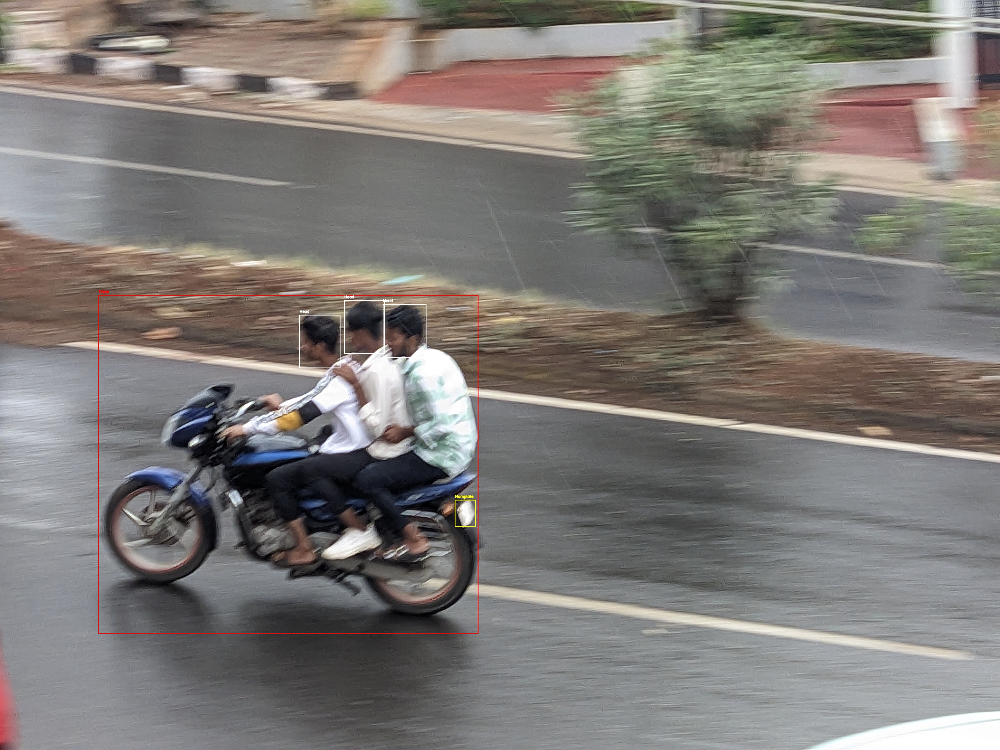![Pasted image (10).jpg](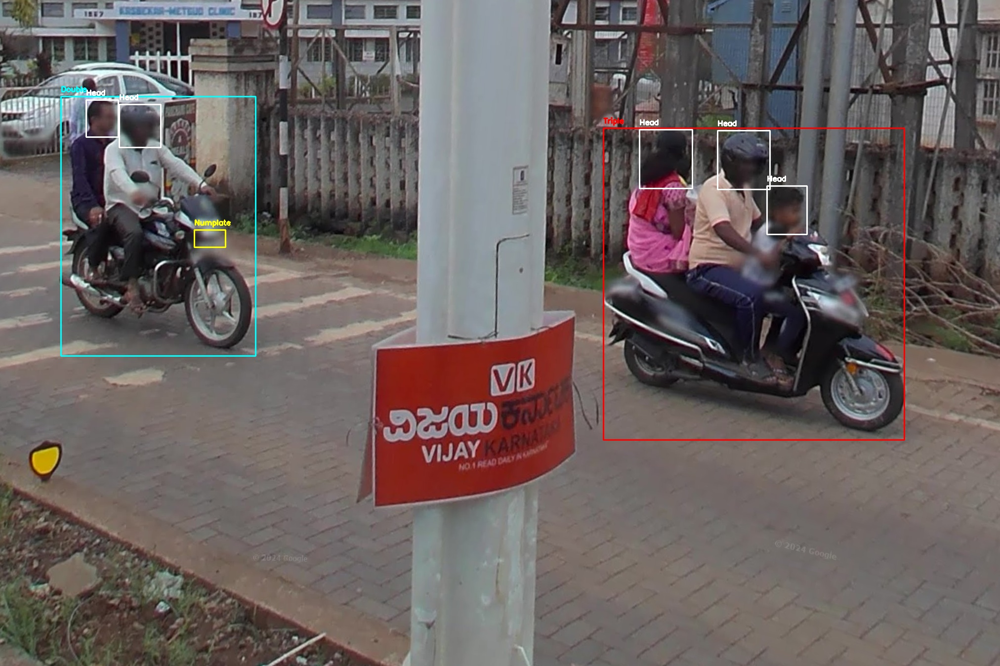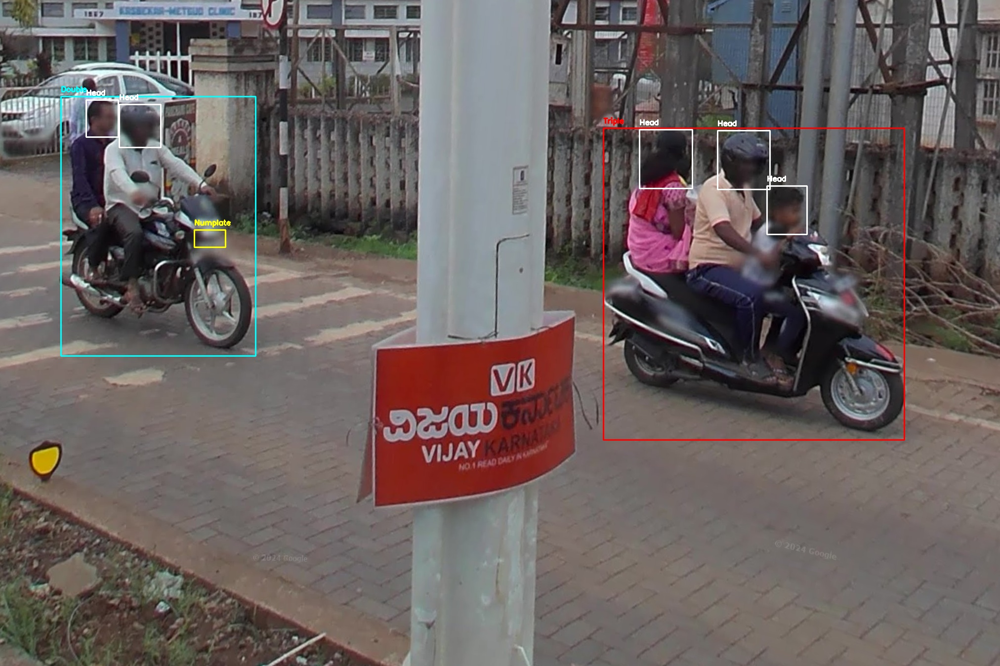))

![PXL_20240510_161057845.jpg](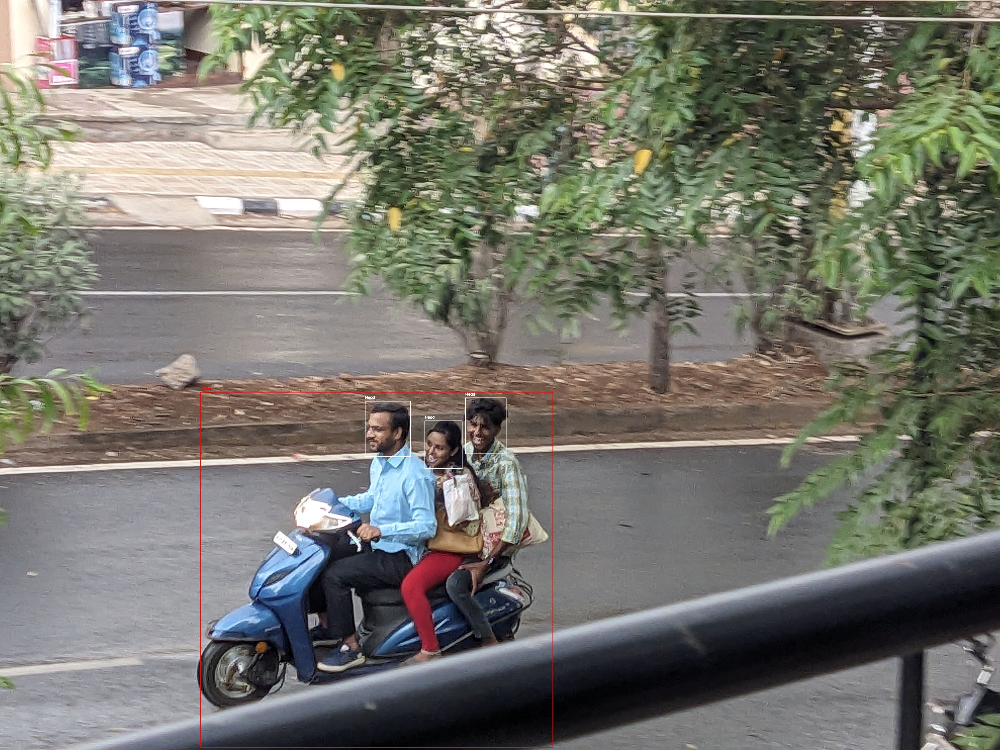![PXL_20240510_155030641.jpg](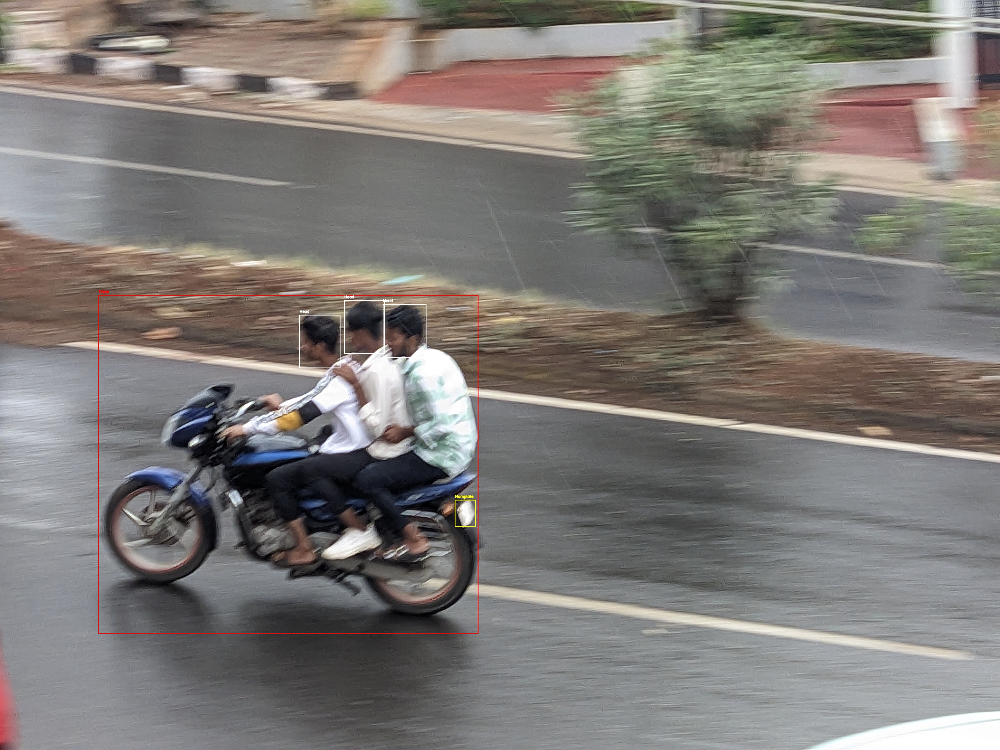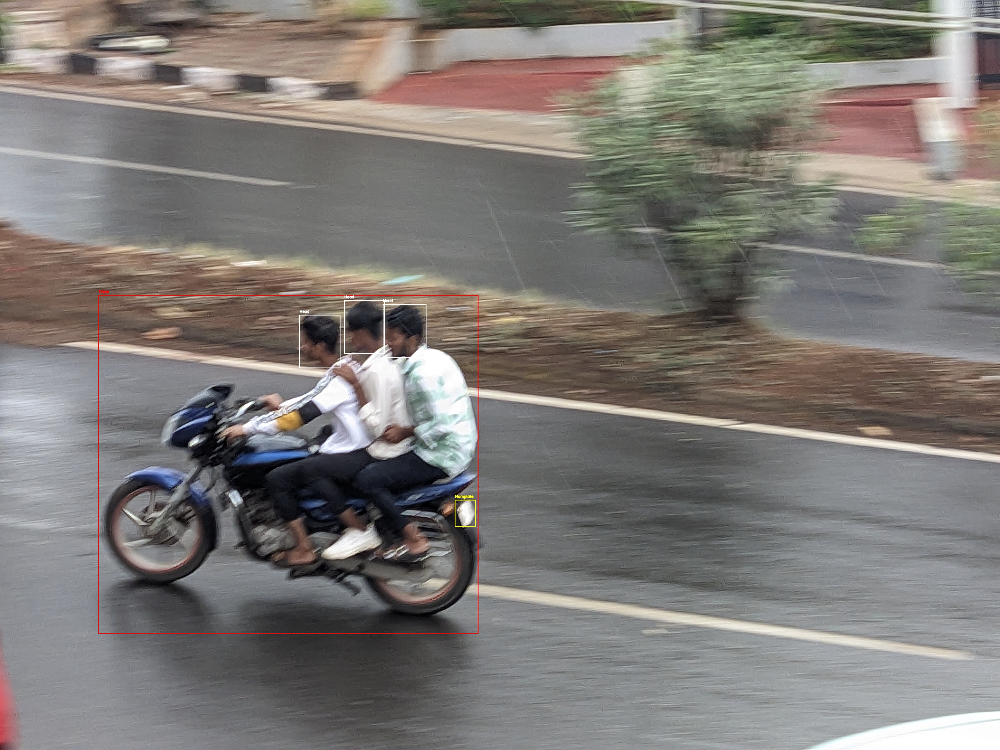))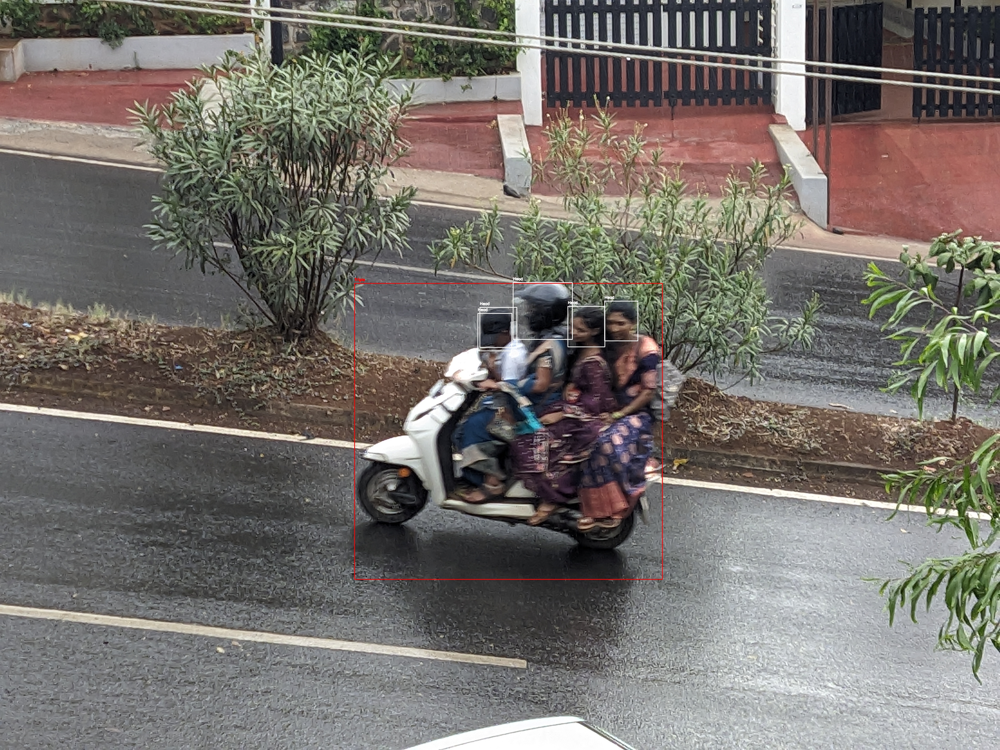

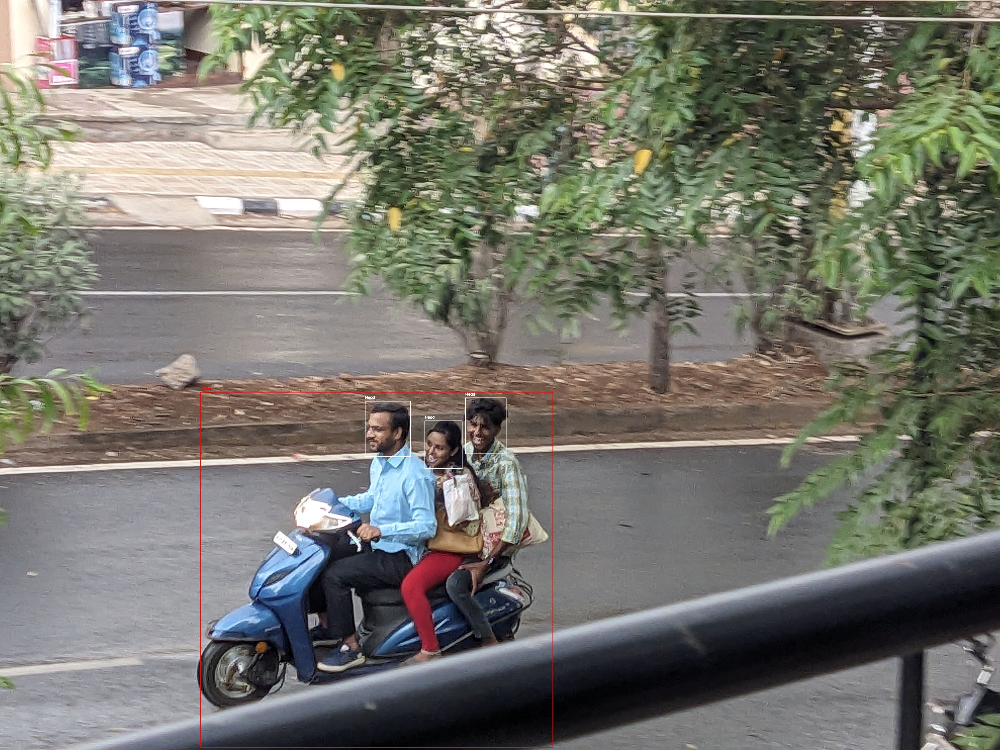